# Self Driving Car: Behavior Cloning Project

## Introduction
This projects uses deep neural networks and convolutional neural networks to clone driving behavior.  
Built in Keras, the model is trained on sequence of images and steering angles collected by driving/steering the car manually in a simulator. 
The model will predict a steering angle which is used to drive an autonomous vehicle.

## Context Setting and Challenges
Training a neural network to build a self driving car is no easy task. Building a machine to mimic human driving requires gathering lot of data parameters. A simple convolutional neural network which has the ability to remember basic patterns in a sequence of high quality images will have more than a million parameters, let alone a network which generalized well and operates perfect in all driving conditions.

In this project, the task is to build a neural network which will only predict the steering angle based on the road conditions. We have access to the a simulator which can be used to manually drive and collect data (images) using good driving behavior.



## Data Collection
Simulator generates sequence of images using 3 cameras mounted on the hood of the car (Center, Left and Right). Steering angle is calculated using the Center camera.

In [68]:
import csv
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
path =  'my_train_data/driving_log.csv'
driving_data = []
with open(path, 'r') as csvfile:
    data = csv.reader(csvfile)
    for row in data:
        driving_data.append(row)

Let's look at a few images obtained using data collection. 
  
We use 3 cameras on the car, the CENTER camera is always used to calculate the steer angle. For us to be able to use LEFT and RIGHT camera images a small correction factor of 0.2 is added to the center steer angle and tag the result to left camera.
Similarly same factor of 0.2 is substracted from the center steer angle and tag the result to right camera. This factor teaches the network to steer back to the center if vehicle is drifting towards the sides of the road.  
  
This correction is very helpful when for example the vehicle sees a left curve, it tells the network to steer a little hard to the right to stay on course. 

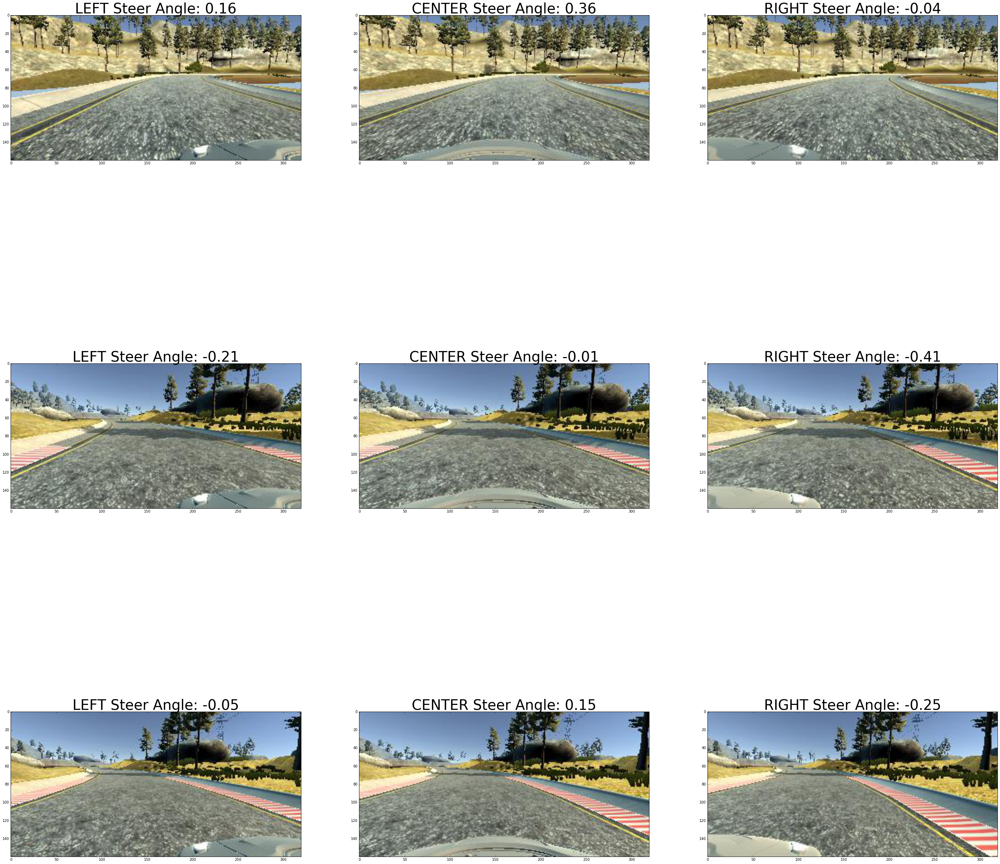

In [121]:
random_idxs = random.sample(range(len(driving_data)), 3)
f, axarr = plt.subplots(3,3, figsize=(50,50))
x_axis = 0
for idx in random_idxs:    
    row = driving_data[idx]
    images = [mpimg.imread(row[0]),mpimg.imread(row[1]),mpimg.imread(row[2])] 
    steer = round(float(row[3]),2)
    left_steer = round(steer + 0.2,2)
    right_steer = round(steer - 0.2,2)
    steer_angles = [left_steer, steer, right_steer]
    image_names = ['CENTER','LEFT','RIGHT']
    
    y_axis = 0
    for i in [1,0,2]:
        axarr[x_axis,y_axis].imshow(images[i])
        axarr[x_axis,y_axis].set_title(image_names[i] + ' Steer Angle: '+ str(steer_angles[i]), fontsize=40)        
        y_axis += 1    
        f.subplots_adjust(hspace=0.2)
        
    x_axis += 1   
plt.show()        

## Data Augmentation
Deep artificial neural networks require a large corpus of training data in order to effectively learn, where collection of such training data is often expensive and laborious. Data augmentation overcomes this issue by artificially inflating the training set with label preserving transformations. Recently there has been extensive use of generic data augmentation to improve Convolutional Neural Network (CNN) task performance.  
[Improving Deep Learning using Generic Data Augmentation](https://arxiv.org/abs/1708.06020)

Data Augmentation is also a regularization technique to generate new training images from existing ones to boost the size of the training set. This will not only help the model learn better, but will also reduce over-fitting.
The idea is to randomly adjust brightness, rotate/flip, vertical/horizontal shift every picture in the training set and
add them back to the training set. This forces the model to be more tolerant to position and orientation of the key pixels in the image.

Using data from 3 cameras with correction factors applied to steering angles is our first step in Data augmentation, which we already did in previous step

### Adjust Brightness of Images
In this step of augmentation, adjust the brightness of the images by selecting a random intensity level for each image.
Intensity level is selected at random to simulate different sunlight conditions in a day. A darker intensity can be as close to driving at night.  
Here are few examples of images after adjusting the brightness.


In [98]:
import numpy as np
def random_brightness_adjust(img):
    new_img = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    brightness_level = (0.2 * np.random.uniform()) + 0.4
    new_img[:,:,2] = new_img[:,:,2] * brightness_level
    new_img = cv2.cvtColor(new_img, cv2.COLOR_HSV2RGB)
    return new_img

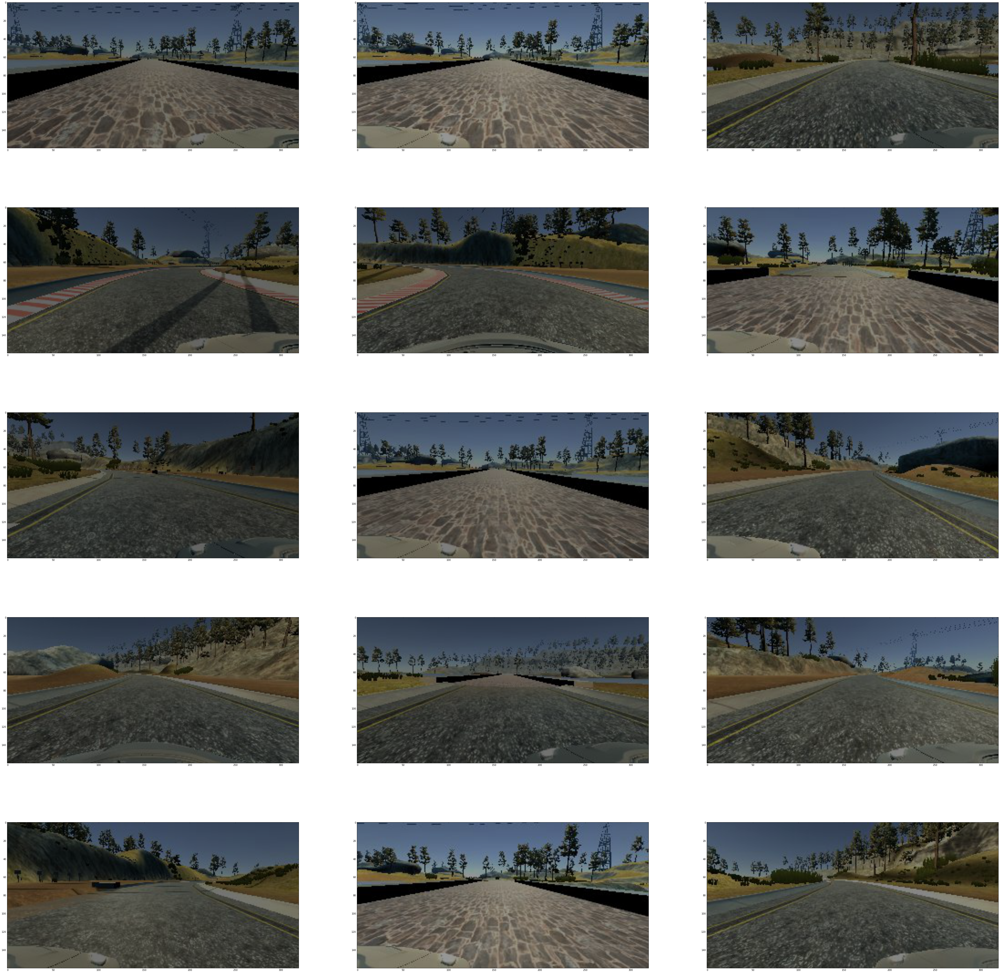

In [100]:
import random
random_idxs = random.sample(range(len(driving_data)), 15)
images = []
for idx in random_idxs:
    row = driving_data[idx]
    clr = random.sample(range(3), 1)[0]
    adj_image = random_brightness_adjust(mpimg.imread(row[clr]))
    images.append(adj_image) 

f, axarr = plt.subplots(5,3, figsize=(75,75))
x_axis = 0
y_axis = 0
for i in range(len(images)):
    if i!=0 and i%3 == 0:
        x_axis += 1
        y_axis = 0
        
    axarr[x_axis,y_axis].imshow(images[i])    
    y_axis += 1
    #f.subplots_adjust(hspace=0 )
plt.show()

### Random Image Flip 
While driving in a loop the model tries to memorize the curves and can get biased if it frequently sees one type of a curve (LEFT/RIGHT). So in autonomous mode, the car tends to steer in that biased direction even if going straight is the best option.  
To be able to generalize the model better, pick a random set of images and flip them counter clockwise. This way, model will observe both the curves and performs better in autonomous mode.  
Here are few flipped images.



In [102]:
def flip_images(img):
    new_img = np.fliplr(img) 
    return new_img
    

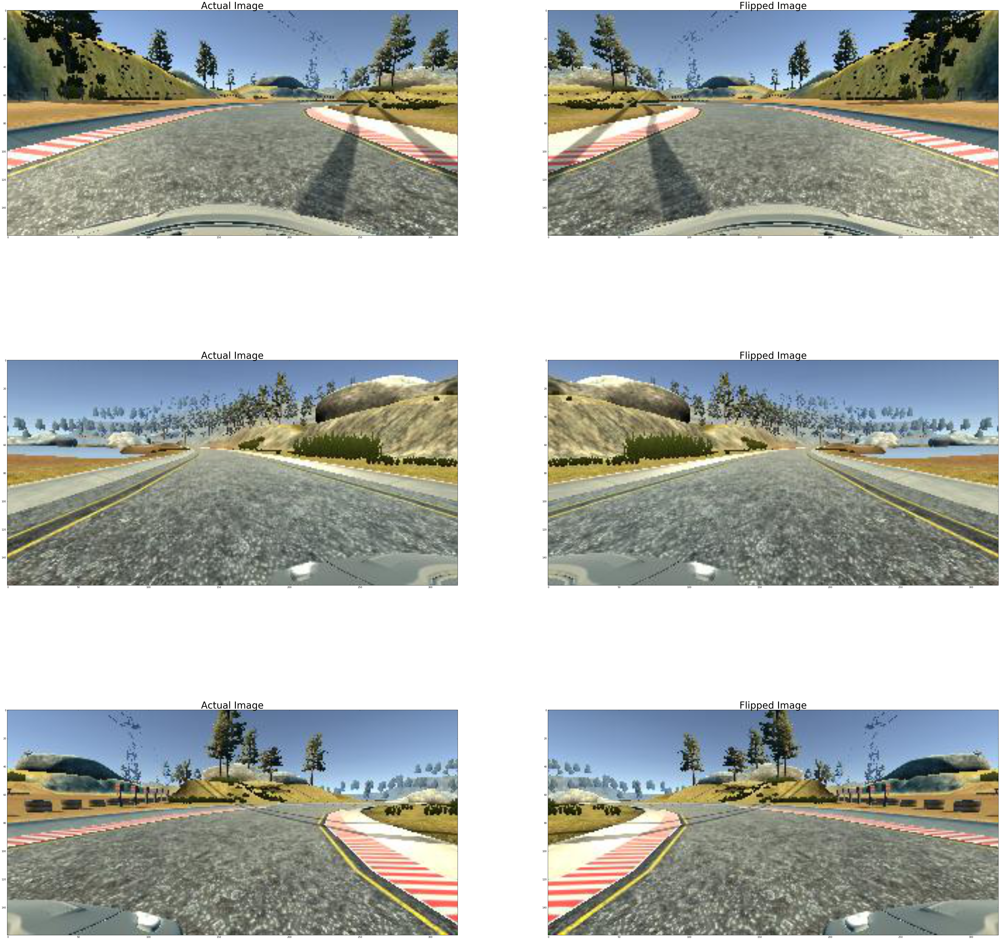

In [105]:
random_idxs = random.sample(range(len(driving_data)), 3)
actual_images = []
flipped_images = []
for idx in random_idxs:
    row = driving_data[idx]
    clr = random.sample(range(3), 1)[0]    
    actual_images.append(mpimg.imread(row[clr]))
    flipped_image = flip_images(mpimg.imread(row[clr]))
    flipped_images.append(flipped_image) 

f, axarr = plt.subplots(3,2, figsize=(75,75))
x_axis = 0
for i in range(len(actual_images)):        
    axarr[x_axis,0].imshow(actual_images[i]) 
    axarr[x_axis,0].set_title('Actual Image', fontsize=40)   
    axarr[x_axis,1].imshow(flipped_images[i])  
    axarr[x_axis,1].set_title('Flipped Image', fontsize=40)   
    x_axis += 1        
    #f.subplots_adjust(hspace=0 )
plt.show()

### Random Veritical Horizontal Shift
This augmentation technique alters the position of an image to new position and orientation, generating new images to simulate the effect of car being is various positions and angles on the road.  
Camera position changes with this shift, hence the steering angle should be rectified accordingly using a correction factor.



In [114]:
def vertical_horizontal_shift(img, label):
    x_shift = 100 * (np.random.rand() - 0.6)
    y_shift = 20 * (np.random.rand() - 0.4)
    new_steer_angle = label + x_shift * 0.003
    transition_matrix = np.float32([[1, 0, x_shift],[0, 1, y_shift]])
    height, width = img.shape[:2]
    new_img = cv2.warpAffine(img, transition_matrix, (width, height))
    return new_img, round(new_steer_angle,2)

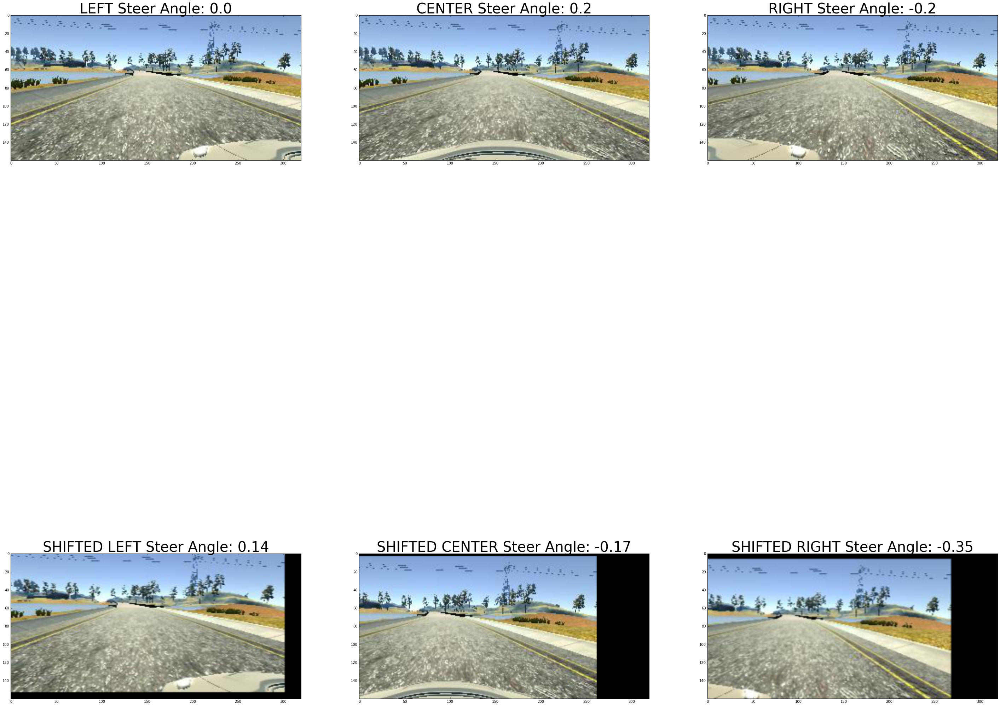

In [123]:
random_idxs = random.sample(range(len(driving_data)), 1)
actual_images = []
shift_images = []
f, axarr = plt.subplots(2,3, figsize=(50,50))
x_axis = 0


for idx in random_idxs:
    row = driving_data[idx]
    actual_images = [mpimg.imread(row[0]),mpimg.imread(row[1]),mpimg.imread(row[2])] 
    steer = round(float(row[3]),2)
    left_steer = round(steer + 0.2,2)
    right_steer = round(steer - 0.2,2)
    actual_steer_angles = [left_steer, steer, right_steer]
    image_names = ['CENTER','LEFT','RIGHT']
    
    shift_center_image, shift_steer = vertical_horizontal_shift(mpimg.imread(row[0]),steer)
    shift_left_image, shift_left_steer = vertical_horizontal_shift(mpimg.imread(row[1]),left_steer)
    shift_rigt_image, shift_right_steer = vertical_horizontal_shift(mpimg.imread(row[2]),right_steer)
    shift_images = [shift_center_image, shift_left_image, shift_rigt_image]
    shift_steer_angles = [shift_steer, shift_left_steer, shift_right_steer]
    
    shift_image_names = ['SHIFTED CENTER','SHIFTED LEFT','SHIFTED RIGHT']
    
    y_axis = 0
    for i in [1,0,2]:
        axarr[x_axis,y_axis].imshow(actual_images[i])
        axarr[x_axis,y_axis].set_title(image_names[i] + ' Steer Angle: '+ str(actual_steer_angles[i]), fontsize=40)        
        y_axis += 1    
        
        
    x_axis += 1
    y_axis = 0
    for i in [1,0,2]:
        axarr[x_axis,y_axis].imshow(shift_images[i])
        axarr[x_axis,y_axis].set_title(shift_image_names[i] + ' Steer Angle: '+ str(shift_steer_angles[i]), fontsize=40)        
        y_axis += 1    
        
plt.show()        



## Image Preprocessing
This steps helps in removing noise from the image. If you observe the images plotted above, almost 1/5th of the image from the top is the sky and around 20 pixels from the bottom is the hood of the car.
These pixels provide no added value to the neural network. Cropping the image to get rid of these pixels will help the neural network look only at the road as the car moves.  
Here's an example how an image looks before and after cropping.

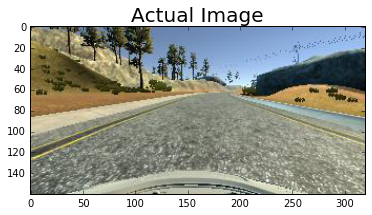

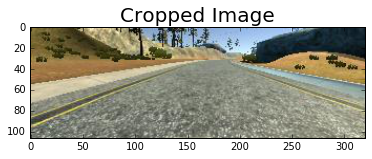

In [161]:
import math
random_idxs = random.sample(range(len(driving_data)), 1)[0]
row = driving_data[random_idxs][0]
image = mpimg.imread(row)

plt.imshow(image)
plt.title('Actual Image', fontsize=20)     
plt.show()

img_shape = image.shape                         
top_crop = math.floor(img_shape[0]/5)
bottom_crop = img_shape[0]-22
cropped_image = image[top_crop:bottom_crop, 0:img_shape[1]]

plt.imshow(cropped_image)
plt.title('Cropped Image', fontsize=20)
plt.show()

### Collected Data
Data Collection and Augmentation resulted in a total of 23,760 images. A total of 17,856 were used for training the CNN and 5,904 images were used as Validation set

## Model Pipeline
Once we have the necessary training images ready (after the data augmentation), construct the model pipeline to train the neural network.  

**Data Normalization** : As for any data-set, image data has been normalized so that the numerical rangeof the pixels is between -1 and 1.  
**Model Pipeline**: 

This architecture used here is published by autonomous vehicle team in NVIDIA. [End-to-End Deep Learning for Self-Driving Cars](https://devblogs.nvidia.com/parallelforall/deep-learning-self-driving-cars/).  
Below is the model pipeline design in brief:

1. Input Image: 160 x 320 x 3
2. Cropped Image: 106 x 320 x 3
3. Normalization Lambda Layer
4. Convolution 1: Kernel size = 5, Feature maps = 24, Strides = 1, Padding = SAME, Output Image: 106 x 320 x 24, Weights Initializer = Truncated Normal, Activation = ELU
5. Maxpool Layer 1: Kernel size = 2, Strides = 2, Padding = 'VALID', Output Image: 53 x 160 x 24
6. Convolution 2: Kernel size = 5, Feature maps = 36, Strides = 1, Padding = SAME, Output Image: 53 x 160 x 36, Weights Initializer = Truncated Normal, Activation = ELU
7. Maxpool Layer 2: Kernel size = 2, Strides = 2, Padding = 'VALID', Output Image: 26 x 80 x 36
8. Convolution 3: Kernel size = 5, Feature maps = 48, Strides = 1, Padding = SAME, Output Image: 26 x 80 x 48, Weights Initializer = Truncated Normal, Activation = ELU
9. Maxpool Layer 3: Kernel size = 2, Strides = 2, Padding = 'VALID', Output Image: 13 x 40 x 48
10. Convolution 4: Kernel size = 3, Feature maps = 64, Strides = 1, Padding = SAME, Output Image: 13 x 40 x 64, Weights Initializer = Truncated Normal, Activation = ELU
11. Maxpool Layer 4: Kernel size = 1, Strides = 1, Padding = 'VALID', Output Image: 13 x 40 x 64
12. Convolution 5: Kernel size = 3, Feature maps = 64, Strides = 1, Padding = SAME, Output Image: 13 x 40 x 64, Weights Initializer = Truncated Normal, Activation = ELU
13. Maxpool Layer 5: Kernel size = 1, Strides = 1, Padding = 'VALID', Output Image: 13 x 40 x 64
14. Flatten : Output = 33280 neurons, Activation = ELU
15. Fully Connected Layer 1: Output = 100 neurons, Activation = ELU
16. Fully Connected Layer 2: Output = 50 neurons, Activation = ELU
17. Fully Connected Layer 3: Output = 10 neurons, Activation = ELU
18. Output Fully Connected Layer: Output = 1 neurons (no of labels)

Convolution 3, Convolution 4, Convolution 5, Flatten and all Fully Connected Layers use Dropout regularization.    
All layers use the weights initially being initialised from a truncated normal distribution with a 0 mean and a
standard deviation of 0.01.
![NVIDIA ARchitecture](NVIDIA CNN Architecture.jpg)


### Hyper Parameters

1. The number of epochs used: 35
2. Learning Rate: 0.01. 
3. Batch size : 32  
4. Momentum

Weights updated using back propagation and stochastic gradient descent optimizer. Learning rate exponential decay was applied with global_step value computed as (learning_rate / epochs).  
When training a model, it is often recommended to lower the learning rate as the training progresses, which helps the model converge and reach global minimum.


## Training
Training the neural network with large number of images loaded into memory may slow down the entire process. Data generator functions in python are used to mitigate this problem by reading the required set of images in chunks using the batch size.

Keras supports a function model.fit_generator which trains the network using the small size chunk of images at a time yieled by the generator function and destroys them saving memory.  
After training for 35 epochs on 17,856 images using a batch size of 32, the model yielded the following results.
![](Loss Graph.jpg)

### Model Performance
Training Data was collected on Track 1. Using the model's steering predictions, the autonomous car was able to drive well following the course of the track. 

In [167]:
from IPython.display import HTML

HTML("""<video width="640" height="580" controls>  <source src="run1.mp4" type="video/mp4"></video>""")

## Next Steps and Improvements
This project has tested my skills on Deep learning and CNNs to the core.    

There is still a lot of room for improvement and in my mind are a few listed below:  
1. How does the car perform on real world data? Record a video by setting up similar cameras in my car and train the network to check if the model gives similar results.
2. Train and improvise the model on Track 2 which is much more challenging (has more turns, loops and various driving conditions)
3. Ability to make the car drive only on right side of the road?

As a final thought, one of the best projects I've worked on till date. At the same time, Requires a lot of patience to get everything right as we try to train the network using different augmenting techniques and hyper parameter settings.  


